In [3]:
import pandas as pd
import numpy as np
import re
import os
import glob
import geopandas as gpd
from shapely.geometry import Point, Polygon, MultiLineString
import osmnx as ox
import matplotlib.pyplot as plt
import networkx as nx
import requests
import plotly.express as px
import urllib.parse

#### Data Sources

Crime Data Source: https://opendataphilly.org/datasets/crime-incidents/

School Data Source: https://opendataphilly.org/datasets/schools/


In [14]:
sql_query = "SELECT * FROM incidents_part1_part2 WHERE dispatch_date BETWEEN '2022-01-01' AND '2024-12-31'"

encoded_query = urllib.parse.quote(sql_query)

base_url = "https://phl.carto.com/api/v2/sql?q="

url = base_url +encoded_query

response = requests.get(url)

data = response.json()

if 'rows' in data:
    CrimeData = pd.DataFrame(data['rows'])
    print(CrimeData.head())
else:
    print("no data")

   cartodb_id                                           the_geom  \
0           2  0101000020E6100000A51C8299A5C752C006342AD3DCFF...   
1           4  0101000020E6100000F9245E3B64CC52C0B7195D940FF6...   
2           7  0101000020E6100000118A52E7F6C052C0CFF41263190C...   
3         123  0101000020E6100000E1F9FB7B5FC552C0159C0B6D4A02...   
4         126  0101000020E6100000D1CCD5875CCA52C014B723FFC005...   

                                the_geom_webmercator  objectid dc_dist psa  \
0  0101000020110F0000F80DE2A145E65FC1E5EC7592BE8F...       114      25   3   
1  0101000020110F00000426B7CE54EE5FC1C5E06D37E284...       116      01   1   
2  0101000020110F00006728CED7EBDA5FC169DB64F8519D...       119      08   2   
3  0101000020110F00009D28D4D968E25FC13CD5C3D06F92...        96      15   1   
4  0101000020110F00002F28E30AE2EA5FC10090A3314796...        99      14   1   

     dispatch_date_time dispatch_date dispatch_time  hour        dc_key  \
0  2023-03-11T17:12:00Z    2023-03-11      12:1

In [ ]:
CrimeData['Year'] = CrimeData['dispatch_date'].str[:4]

In [17]:
datapath_schools = '../Crime Data/Schools/'
dfiles_schools = os.listdir(datapath_schools)
data = str('School_')

In [13]:
def load_data_school(school):
    stringData = str(school)
    file = [f for f in dfiles_schools if data in f][0]
    sourcepath = os.path.join(datapath_schools,file)
    currentframe = pd.read_csv(sourcepath)
    #currentframe_filt = currentframe[currentframe['TYPE_SPECIFIC']=='DISTRICT']
    return currentframe

In [20]:
CrimeData.head()

,cartodb_id,the_geom,the_geom_webmercator,objectid,dc_dist,psa,dispatch_date_time,dispatch_date,dispatch_time,hour,dc_key,location_block,ucr_general,text_general_code,point_x,point_y,Year
0,2,0101000020E6100000A51C8299A5C752C006342AD3DCFF...,0101000020110F0000F80DE2A145E65FC1E5EC7592BE8F...,114,25,3,2023-03-11T17:12:00Z,2023-03-11,12:12:00,12.0,202325014482,3300 BLOCK HARTVILLE ST,300,Robbery No Firearm,-75.119482,39.998927,2023
1,4,0101000020E6100000F9245E3B64CC52C0B7195D940FF6...,0101000020110F00000426B7CE54EE5FC1C5E06D37E284...,116,01,1,2023-03-11T18:31:00Z,2023-03-11,13:31:00,13.0,202301004597,2400 BLOCK S 28TH ST,600,Theft from Vehicle,-75.193618,39.922350,2023
2,7,0101000020E6100000118A52E7F6C052C0CFF41263190C...,0101000020110F00006728CED7EBDA5FC169DB64F8519D...,119,08,2,2023-03-11T22:13:00Z,2023-03-11,17:13:00,17.0,202308008412,9800 BLOCK Roosevelt Blvd,600,Thefts,-75.015070,40.094525,2023
3,123,0101000020E6100000E1F9FB7B5FC552C0159C0B6D4A02...,0101000020110F00009D28D4D968E25FC13CD5C3D06F92...,96,15,1,2023-03-11T12:42:00Z,2023-03-11,07:42:00,7.0,202315017366,4700 BLOCK GRISCOM ST,600,Thefts,-75.083953,40.017896,2023
4,126,0101000020E6100000D1CCD5875CCA52C014B723FFC005...,0101000020110F00002F28E30AE2EA5FC10090A3314796...,99,14,1,2023-03-12T00:54:00Z,2023-03-11,19:54:00,19.0,202314012625,5500 BLOCK BLOYD ST,300,Robbery No Firearm,-75.161898,40.044952,2023


### Crime Shapes

In [22]:
crs = {'init':'epsg:4326'}

In [24]:
geometry = [Point(xy) for xy in zip(CrimeData['point_x'],CrimeData['point_y'])]

In [25]:
geometry[:3]

[<POINT (-75.1 40)>, <POINT (-75.2 39.9)>, <POINT (-75 40.1)>]

In [26]:
geo_df = gpd.GeoDataFrame(CrimeData,
                          crs=crs,
                          geometry=geometry)
geo_df.head()

/Users/evanwise/anaconda3/lib/python3.11/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,cartodb_id,the_geom,the_geom_webmercator,objectid,dc_dist,psa,dispatch_date_time,dispatch_date,dispatch_time,hour,dc_key,location_block,ucr_general,text_general_code,point_x,point_y,Year,geometry
0,2,0101000020E6100000A51C8299A5C752C006342AD3DCFF...,0101000020110F0000F80DE2A145E65FC1E5EC7592BE8F...,114,25,3,2023-03-11T17:12:00Z,2023-03-11,12:12:00,12.0,202325014482,3300 BLOCK HARTVILLE ST,300,Robbery No Firearm,-75.119482,39.998927,2023,POINT (-75.11948 39.99893)
1,4,0101000020E6100000F9245E3B64CC52C0B7195D940FF6...,0101000020110F00000426B7CE54EE5FC1C5E06D37E284...,116,01,1,2023-03-11T18:31:00Z,2023-03-11,13:31:00,13.0,202301004597,2400 BLOCK S 28TH ST,600,Theft from Vehicle,-75.193618,39.922350,2023,POINT (-75.19362 39.92235)
2,7,0101000020E6100000118A52E7F6C052C0CFF41263190C...,0101000020110F00006728CED7EBDA5FC169DB64F8519D...,119,08,2,2023-03-11T22:13:00Z,2023-03-11,17:13:00,17.0,202308008412,9800 BLOCK Roosevelt Blvd,600,Thefts,-75.015070,40.094525,2023,POINT (-75.01507 40.09452)
3,123,0101000020E6100000E1F9FB7B5FC552C0159C0B6D4A02...,0101000020110F00009D28D4D968E25FC13CD5C3D06F92...,96,15,1,2023-03-11T12:42:00Z,2023-03-11,07:42:00,7.0,202315017366,4700 BLOCK GRISCOM ST,600,Thefts,-75.083953,40.017896,2023,POINT (-75.08395 40.01790)
4,126,0101000020E6100000D1CCD5875CCA52C014B723FFC005...,0101000020110F00002F28E30AE2EA5FC10090A3314796...,99,14,1,2023-03-12T00:54:00Z,2023-03-11,19:54:00,19.0,202314012625,5500 BLOCK BLOYD ST,300,Robbery No Firearm,-75.161898,40.044952,2023,POINT (-75.16190 40.04495)


In [27]:
geo_df.columns

Index(['cartodb_id', 'the_geom', 'the_geom_webmercator', 'objectid', 'dc_dist',
       'psa', 'dispatch_date_time', 'dispatch_date', 'dispatch_time', 'hour',
       'dc_key', 'location_block', 'ucr_general', 'text_general_code',
       'point_x', 'point_y', 'Year', 'geometry'],
      dtype='object')

<Axes: >

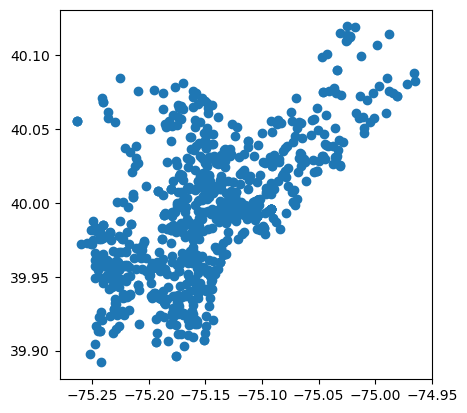

In [28]:
geo_df[(geo_df['text_general_code']=='DRIVING UNDER THE INFLUENCE')& (geo_df['Year']=='2022')].plot()

### Crime Data Cleaning

In [ ]:
CrimeData.dtypes

the_geom                 object
cartodb_id                int64
the_geom_webmercator     object
objectid                  int64
dc_dist                   int64
psa                      object
dispatch_date_time       object
dispatch_date            object
dispatch_time            object
hour                    float64
dc_key                  float64
location_block           object
ucr_general               int64
text_general_code        object
point_x                 float64
point_y                 float64
lat                     float64
lng                     float64
Year                     object
dtype: object

In [30]:
Crime_Data = CrimeData.astype({'cartodb_id':str,'objectid':str,'dc_dist':str,'dc_key':str,'ucr_general':str})
Crime_Data['hour'] = np.where(Crime_Data['hour'].isna(),Crime_Data['dispatch_time'].astype(str).str[:2],Crime_Data['hour'])
Crime_Data['hour'] = pd.to_numeric(Crime_Data['hour'])
Crime_Data = Crime_Data[~Crime_Data['point_y'].isna()]
Crime_Data['psa'] = Crime_Data['psa'].fillna('0',inplace=True)

In [31]:
Crime_Data['text_general_code'] = Crime_Data['text_general_code'].str.strip()

In [32]:
Crime_Data['AM_PM'] = np.where(Crime_Data['hour']>12,'PM','AM')

### Crime Data Exploratory

In [38]:
Crime_Data['text_general_code'].describe()

count     465900
unique        32
top       Thefts
freq      107289
Name: text_general_code, dtype: object

In [39]:
px.histogram(Crime_Data,
             x='Year',
             nbins=24,
             title='Distribution of Year')

In [40]:
px.histogram(Crime_Data,
             x='text_general_code',
             nbins=24,
             title='Distribution of Crime')

In [41]:
px.scatter(Crime_Data,
           x='text_general_code',
           y='dc_dist',
           color='AM_PM')

## Schools Data

In [42]:
SchoolData = load_data_school('School')

In [43]:
SchoolData.head()

,X,Y,OBJECTID,AUN,SCHOOL_NUM,LOCATION_ID,SCHOOL_NAME,SCHOOL_NAME_LABEL,STREET_ADDRESS,ZIP_CODE,PHONE_NUMBER,ACTIVE,GRADE_LEVEL,GRADE_ORG,ENROLLMENT,TYPE,TYPE_SPECIFIC
0,-75.181783,39.946889,1,226515462.0,NaN,NaN,PHILADELPHIA SCHOOL,PHILADELPHIA SCHOOL,2501-29 LOMBARD ST,19146,(215) 545-5323,O,ELEMENTARY/MIDDLE,PREK-8,NaN,3,PRIVATE
1,-75.227420,39.935171,2,300512620.0,NaN,NaN,CORNERSTONE CHRISTIAN ACADEMY,CORNERSTONE CHRISTIAN ACADEMY,1939 S 58TH ST,19143,(215) 724-6858,O,ELEMENTARY/MIDDLE,K-8,NaN,3,PRIVATE
2,-75.231360,39.992115,3,226512842.0,NaN,NaN,JAMESON CHRISTIAN ACADEMY,JAMESON CHRISTIAN ACADEMY,5301 WYNNEFIELD AVE,19131,(215) 477-7777,O,ELEMENTARY/MIDDLE/HIGH,K-12,NaN,3,PRIVATE
3,-75.141410,39.973856,4,226510132.0,NaN,NaN,AL-AQSA ISLAMIC SCHOOL,AL-AQSA ISLAMIC SCHOOL,1501-11 GERMANTOWN AVE,19122,215) 765-6660,O,ELEMENTARY/MIDDLE/HIGH,K-12,NaN,3,PRIVATE
4,-75.102019,39.984963,5,226514552.0,NaN,NaN,OUR LADY OF PORT RICHMOND SCHOOL,OUR LADY OF PORT RICHMOND SCHOOL,2639 E ALLEGHENY AVE,19134,(215) 739-1920,O,ELEMENTARY/MIDDLE,PREK-8,NaN,3,ARCHDIOCESE


In [101]:
SchoolData['TYPE_SPECIFIC'].unique()

array(['PRIVATE', 'ARCHDIOCESE', 'DISTRICT', 'CHARTER', 'CONTRACTED'],
      dtype=object)

In [193]:
crs = {'init':'epsg:4326'}
geometry_schools = [Point(xy) for xy in zip(SchoolData['X'],SchoolData['Y'])]
School_geos = gpd.GeoDataFrame(SchoolData,
                          crs=crs,
                          geometry=geometry_schools)

/Users/evanwise/anaconda3/lib/python3.11/site-packages/pyproj/crs/crs.py:141: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



In [103]:
DistrictSchools =School_geos[School_geos['TYPE_SPECIFIC']=='DISTRICT']
PrivateSchools = School_geos[School_geos['TYPE_SPECIFIC']=='PRIVATE']
CatholicSchools = School_geos[School_geos['TYPE_SPECIFIC']=='ARCHDIOCESE']
ContractedSchools = School_geos[School_geos['TYPE_SPECIFIC']=='CONTRACTED']


In [105]:
DistrictXY = DistrictSchools[['Y','X']]
DistrictList = list(zip(DistrictSchools['Y'],DistrictSchools['X']))


In [109]:
print(School_geos.crs)


+init=epsg:4326 +type=crs


In [194]:
School_geos = School_geos.to_crs(32618) #UTM Zone 18N
feet_to_meters = 0.3048 # 1 foot = 0.3048 meters
buffer_distance_meters = 200 * feet_to_meters

School_geos['Buffer_200ft'] = School_geos['geometry'].buffer(buffer_distance_meters)
SchoolBuffer_GDF = gpd.GeoDataFrame(School_geos,geometry='Buffer_200ft',crs=4326)
SchoolBuffer_GDF = SchoolBuffer_GDF.drop(columns='geometry')

In [195]:
SchoolBuffer_GDF

,X,Y,OBJECTID,AUN,SCHOOL_NUM,LOCATION_ID,SCHOOL_NAME,SCHOOL_NAME_LABEL,STREET_ADDRESS,ZIP_CODE,PHONE_NUMBER,ACTIVE,GRADE_LEVEL,GRADE_ORG,ENROLLMENT,TYPE,TYPE_SPECIFIC,Buffer_200ft
0,-75.181783,39.946889,1,226515462.0,NaN,NaN,PHILADELPHIA SCHOOL,PHILADELPHIA SCHOOL,2501-29 LOMBARD ST,19146,(215) 545-5323,O,ELEMENTARY/MIDDLE,PREK-8,NaN,3,PRIVATE,"POLYGON ((484531.95767 4421878.25039, 484531.6..."
1,-75.227420,39.935171,2,300512620.0,NaN,NaN,CORNERSTONE CHRISTIAN ACADEMY,CORNERSTONE CHRISTIAN ACADEMY,1939 S 58TH ST,19143,(215) 724-6858,O,ELEMENTARY/MIDDLE,K-8,NaN,3,PRIVATE,"POLYGON ((480630.12011 4420586.61042, 480629.8..."
2,-75.231360,39.992115,3,226512842.0,NaN,NaN,JAMESON CHRISTIAN ACADEMY,JAMESON CHRISTIAN ACADEMY,5301 WYNNEFIELD AVE,19131,(215) 477-7777,O,ELEMENTARY/MIDDLE/HIGH,K-12,NaN,3,PRIVATE,"POLYGON ((480309.88327 4426907.65523, 480309.5..."
3,-75.141410,39.973856,4,226510132.0,NaN,NaN,AL-AQSA ISLAMIC SCHOOL,AL-AQSA ISLAMIC SCHOOL,1501-11 GERMANTOWN AVE,19122,215) 765-6660,O,ELEMENTARY/MIDDLE/HIGH,K-12,NaN,3,PRIVATE,"POLYGON ((487985.66503 4424865.07812, 487985.3..."
4,-75.102019,39.984963,5,226514552.0,NaN,NaN,OUR LADY OF PORT RICHMOND SCHOOL,OUR LADY OF PORT RICHMOND SCHOOL,2639 E ALLEGHENY AVE,19134,(215) 739-1920,O,ELEMENTARY/MIDDLE,PREK-8,NaN,3,ARCHDIOCESE,"POLYGON ((491350.74036 4426093.20777, 491350.4..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
485,-75.175937,39.921023,486,NaN,NaN,NaN,ST MONICA SCHOOL (JUNIOR SCHOOL),ST MONICA SCHOOL (JUNIOR SCHOOL),1700 RITNER ST,19145,(215) 334-3777,NaN,ELEMENTARY SCHOOL,K-4,NaN,3,ARCHDIOCESE,"POLYGON ((485025.71926 4419006.44619, 485025.4..."
486,-75.159661,39.950135,487,326514392.0,NaN,NaN,K012 KIDS SCHOOL,K012 KIDS SCHOOL,1112 CHESTNUT ST,19102,(215) 545-2930,NaN,PRE-K/ELEMENTARY,PREK-2,NaN,3,PRIVATE,"POLYGON ((486422.40945 4422234.88767, 486422.1..."
487,-75.214669,39.999956,488,326512996.0,NaN,NaN,NEW OAKS ACADEMY,NEW OAKS ACADEMY,4200 MONUMENT ST,19131,(215) 929-8829,NaN,UNGRADED,UNGRADED,NaN,3,PRIVATE,"POLYGON ((481736.83774 4427774.38282, 481736.5..."
488,-75.186011,40.001600,489,300515320.0,NaN,NaN,PRODIGY LEARNING CENTERS,PRODIGY LEARNING CENTERS,3345 W HUNTING PARK AVE,19132,(215) 228-7678,NaN,PRE-K/ELEMENTARY,PREK-5,NaN,3,PRIVATE,"POLYGON ((484183.49130 4427951.33051, 484183.1..."


In [196]:
SchoolBuffer_GDF.to_file('SchoolBuffer_GDF.geojson')

Text(0.5, 1.0, 'Buffered Schools')

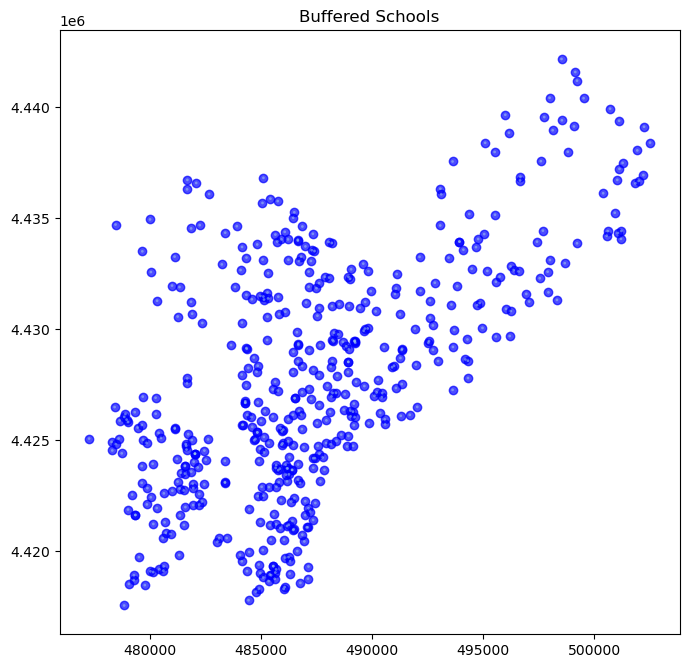

In [197]:
ax = School_geos.plot(facecolor='blue',alpha=0.7, figsize=(8,8))
School_geos.set_geometry('Buffer_200ft').plot(ax=ax,facecolor='lightblue',alpha=0.5)

ax.set_title('Buffered Schools')

## Streets

In [15]:
DistrictList[0:5]

[(39.9502520000276, -75.1523359999574),
 (39.9944190479345, -75.1148200223767),
 (40.0255260001875, -75.1460740001465),
 (40.0224720000888, -75.2068019997144),
 (40.0026291206135, -75.1299362503674)]

In [ ]:
#DistrictList
for tup in DistrictList:
    Y, X = tup
    result = Y,X
    print(result)
    

AttributeError: 'list' object has no attribute 'graph'

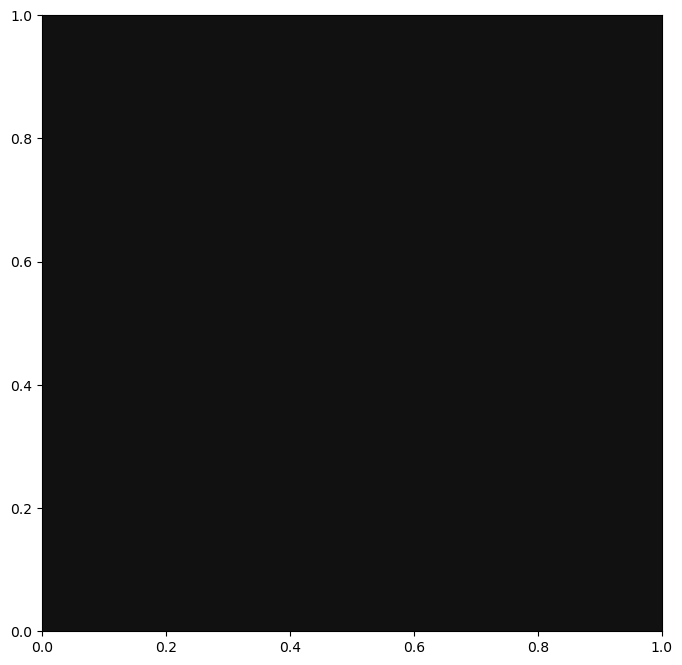

In [25]:
location_point = DistrictList[0:5]
graph1 = nx.Graph()
for f in location_point:
   G = ox.graph_from_point(f,dist=153,dist_type='bbox',network_type='drive')
   Gs.append(G)
   fig,ax=ox.plot_graph(Gs,node_color="r")


#fig,ax = ox.plot_graph(g,node_color="r")
#G = ox.graph_from_point(location_point,dist=153,dist_type='bbox',network_type='drive')
#fig,ax = ox.plot_graph(G,node_color="r")

In [36]:
place_name = "Philadelphia, United States of America"

graph = ox.graph_from_place(place_name)

type(graph)

networkx.classes.multidigraph.MultiDiGraph

In [38]:
ox.io.save_graph_geopackage(graph,filepath='../Crime Data/PhiladelphiaStreets.gpkg',encoding='utf-8',directed=False)

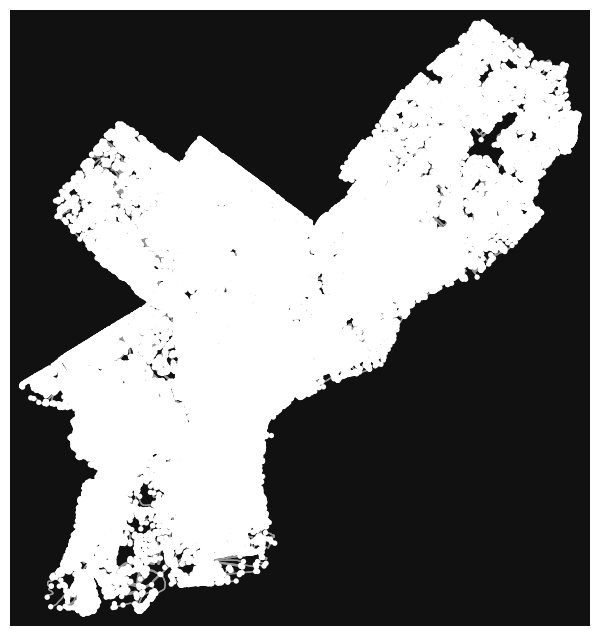

<Figure size 640x480 with 0 Axes>

In [37]:
fig, ax = ox.plot_graph(graph)

plt.tight_layout()

In [30]:
#area = ox.gdf_from_place(place_name)
buildings = ox.buildings_from_place(place_name)

AttributeError: module 'osmnx' has no attribute 'buildings_from_place'

In [32]:
nodes, edges = ox.graph_to_gdfs(graph)
nodes.head()
edges.head()

## Geographic Analysis

In [198]:
SchoolBuffer_GDF.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [168]:
Crime_Data_geo = Crime_Data_geo.to_crs(32618)


In [218]:

# Perform a spatial join between points_gdf and polygons_gdf
School_crime_intersection = gpd.sjoin(Crime_Data_geo,SchoolBuffer_GDF,how='inner',op='intersects')



/Users/evanwise/anaconda3/lib/python3.11/site-packages/IPython/core/interactiveshell.py:3466: FutureWarning:

The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.

/var/folders/k5/1qrkb58x6nn6nr4y1p7c9m100000gn/T/ipykernel_18977/2554134439.py:2: UserWarning:

CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:32618
Right CRS: EPSG:4326




In [221]:
School_crime_intersection = School_crime_intersection.rename(columns={'objectid':'Crime_objectid','OBJECTID':'School_objectid'})

In [222]:
#cleaning up the columns
School_crime_intersection.columns = School_crime_intersection.columns.str.lower().str.strip()
School_crime_intersection['school_name_label'] = School_crime_intersection['school_name_label'].str.lower().str.strip()

In [223]:
School_crime_intersection.to_file('School_crime_intersection.geojson')

## Cleaning Columns for Model

In [276]:
px.histogram(School_crime_intersection,
             x='text_general_code',
             color='grade_level',
             nbins=24,
             title='Distribution of Crime')

In [237]:
px.histogram(School_crime_intersection,
             x='text_general_code',
             nbins=24,
             title='Distribution of Crime')

#### Cleaning up Grade Levels

In [270]:
to_remove = ['new oaks academy','green tree school']

School_crime_intersection = School_crime_intersection[~School_crime_intersection['school_name_label'].isin(to_remove)]

grade_level
ELEMENTARY/MIDDLE         5990
HIGH SCHOOL               3666
ELEMENTARY SCHOOL         2396
MIDDLE SCHOOL             1668
PRE-K/ELEMENTARY          1043
ELEMENTARY/MIDDLE/HIGH     769
MIDDLE/HIGH                522
Name: count, dtype: int64

In [266]:
School_crime_intersection['grade_level'] = np.where(School_crime_intersection['grade_org']=='9-12','HIGH SCHOOL',
                                           np.where(School_crime_intersection['grade_level']=='PRE-K/KINDERGARTEN','PRE-K/ELEMENTARY',
                                                    School_crime_intersection['grade_level']))

/Users/evanwise/anaconda3/lib/python3.11/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [277]:
School_crime_intersection.head()

,the_geom,cartodb_id,the_geom_webmercator,crime_objectid,dc_dist,psa,dispatch_date_time,dispatch_date,dispatch_time,hour,...,school_name_label,street_address,zip_code,phone_number,active,grade_level,grade_org,enrollment,type,type_specific
631,0101000020E610000027A21D3F6DCF52C0BCB71AC078FD...,229218,0101000020110F0000904821A57CF35FC168CE4114188D...,233297,19,None,2020-05-27 22:39:00+00,2020-05-27,18:39:00,18.0,...,bridge way school,7360 JACKSON ST,19136,(267) 437-2194,O,HIGH SCHOOL,9-12,NaN,3,PRIVATE
49241,0101000020E6100000BAB8F0306BCF52C02D150AC762FD...,362018,0101000020110F0000E13A5E2779F35FC12C8AADB9FF8C...,381713,19,None,2020-02-29 22:08:00+00,2020-02-29,17:08:00,17.0,...,bridge way school,7360 JACKSON ST,19136,(267) 437-2194,O,HIGH SCHOOL,9-12,NaN,3,PRIVATE
69390,0101000020E610000027A21D3F6DCF52C0BCB71AC078FD...,1273560,0101000020110F0000904821A57CF35FC168CE4114188D...,1290693,19,None,2020-05-02 22:30:00+00,2020-05-02,18:30:00,18.0,...,bridge way school,7360 JACKSON ST,19136,(267) 437-2194,O,HIGH SCHOOL,9-12,NaN,3,PRIVATE
73737,0101000020E6100000BAB8F0306BCF52C02D150AC762FD...,1278232,0101000020110F0000E13A5E2779F35FC12C8AADB9FF8C...,1290144,19,None,2020-05-03 07:35:00+00,2020-05-03,03:35:00,3.0,...,bridge way school,7360 JACKSON ST,19136,(267) 437-2194,O,HIGH SCHOOL,9-12,NaN,3,PRIVATE
77585,0101000020E610000027A21D3F6DCF52C0BCB71AC078FD...,1282617,0101000020110F0000904821A57CF35FC168CE4114188D...,1284833,19,None,2020-07-13 16:30:00+00,2020-07-13,12:30:00,12.0,...,bridge way school,7360 JACKSON ST,19136,(267) 437-2194,O,HIGH SCHOOL,9-12,NaN,3,PRIVATE


## Recoding Variables

* if  a categorical column has just two categories, then replace values with 0 and 1.
* if a categorical column has more than 2 categories, perform one-hot encoding which creates a new column for each category with 1s and 0s.
* if the categories have a natural order (cold, neutral, warm, hot) then they can be converted to numbers (1,2,3,4) preserving the order - called ordinals

In [278]:
School_crime_intersection.columns
[['crime_objectid','dc_dist','dispatch_date','hour','location_block','']]

Index(['the_geom', 'cartodb_id', 'the_geom_webmercator', 'crime_objectid',
       'dc_dist', 'psa', 'dispatch_date_time', 'dispatch_date',
       'dispatch_time', 'hour', 'dc_key', 'location_block', 'ucr_general',
       'text_general_code', 'point_x', 'point_y', 'lat', 'lng', 'year',
       'am_pm', 'geometry', 'index_right', 'x', 'y', 'school_objectid', 'aun',
       'school_num', 'location_id', 'school_name', 'school_name_label',
       'street_address', 'zip_code', 'phone_number', 'active', 'grade_level',
       'grade_org', 'enrollment', 'type', 'type_specific'],
      dtype='object')

In [283]:
School_crime_intersection[['dispatch_date_time','dispatch_date','location_block','ucr_general']]

,dispatch_date_time,dispatch_date,location_block,ucr_general
631,2020-05-27 22:39:00+00,2020-05-27,6000 BLOCK W OXFORD ST,600
49241,2020-02-29 22:08:00+00,2020-02-29,6000 BLOCK NASSAU RD,600
69390,2020-05-02 22:30:00+00,2020-05-02,1800 BLOCK N 60TH ST,1400
73737,2020-05-03 07:35:00+00,2020-05-03,5900 BLOCK NASSAU RD,1400
77585,2020-07-13 16:30:00+00,2020-07-13,5900 BLOCK W OXFORD ST,1100
...,...,...,...,...
579416,2023-12-01 19:00:00+00,2023-12-01,1700 BLOCK TOMLINSON RD,800
587278,2023-11-29 16:35:00+00,2023-11-29,1700 BLOCK TOMLINSON RD,800
585254,2023-12-02 01:15:00+00,2023-12-01,6300 BLOCK MALVERN AV,800
585576,2023-12-06 13:21:00+00,2023-12-06,3000 BLOCK COTTMAN AV,1400


In [289]:
School_crime_intersection[['ucr_general','text_general_code']].value_counts().reset_index().sort_values('ucr_general')

,ucr_general,text_general_code,count
21,100,Homicide - Criminal,42
23,1000,Forgery and Counterfeiting,21
7,1100,Fraud,576
25,1200,Embezzlement,15
18,1300,Receiving Stolen Property,72
3,1400,Vandalism/Criminal Mischief,1510
10,1500,Weapon Violations,355
24,1600,Prostitution and Commercialized Vice,15
15,1700,Other Sex Offenses (Not Commercialized),148
8,1800,Narcotic / Drug Law Violations,524


In [295]:
violent_crime = ['100','200','300','400','2000']

School_crime_intersection[School_crime_intersection['ucr_general'].isin(violent_crime)]

,the_geom,cartodb_id,the_geom_webmercator,crime_objectid,dc_dist,psa,dispatch_date_time,dispatch_date,dispatch_time,hour,...,school_name_label,street_address,zip_code,phone_number,active,grade_level,grade_org,enrollment,type,type_specific
183576,0101000020E610000027A21D3F6DCF52C0BCB71AC078FD...,282411,0101000020110F0000904821A57CF35FC168CE4114188D...,290812,19,None,2021-02-28 02:17:00+00,2021-02-27,21:17:00,21.0,...,bridge way school,7360 JACKSON ST,19136,(267) 437-2194,O,HIGH SCHOOL,9-12,NaN,3,PRIVATE
188800,0101000020E610000027A21D3F6DCF52C0BCB71AC078FD...,297336,0101000020110F0000904821A57CF35FC168CE4114188D...,294375,19,None,2021-01-24 01:56:00+00,2021-01-23,20:56:00,20.0,...,bridge way school,7360 JACKSON ST,19136,(267) 437-2194,O,HIGH SCHOOL,9-12,NaN,3,PRIVATE
315100,0101000020E610000027A21D3F6DCF52C0BCB71AC078FD...,206070,0101000020110F0000904821A57CF35FC168CE4114188D...,207832,19,None,2022-11-23 16:38:00+00,2022-11-23,11:38:00,11.0,...,bridge way school,7360 JACKSON ST,19136,(267) 437-2194,O,HIGH SCHOOL,9-12,NaN,3,PRIVATE
337541,0101000020E610000027A21D3F6DCF52C0BCB71AC078FD...,279717,0101000020110F0000904821A57CF35FC168CE4114188D...,256184,19,None,2022-02-07 05:44:00+00,2022-02-07,00:44:00,0.0,...,bridge way school,7360 JACKSON ST,19136,(267) 437-2194,O,HIGH SCHOOL,9-12,NaN,3,PRIVATE
419673,0101000020E6100000EC45FEAA6DCF52C01BE4E4347AFD...,3122108,0101000020110F0000D0EC5E5C7DF35FC1237A71B1198D...,8177594,19,None,2022-04-09 04:00:00+00,2022-04-09,00:00:00,0.0,...,bridge way school,7360 JACKSON ST,19136,(267) 437-2194,O,HIGH SCHOOL,9-12,NaN,3,PRIVATE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
570866,0101000020E61000001AEA030B58C352C0127341642E02...,3153774,0101000020110F000055CD1087F6DE5FC1B7F0F1B95092...,12915253,15,None,2023-12-04 20:16:00+00,2023-12-04,15:16:00,15.0,...,tacony academy charter school (high school),6201 KEYSTONE ST,19135,(215) 515-5900,O,HIGH SCHOOL,9-12,NaN,2,CHARTER
564053,0101000020E6100000DEDB5F0343D052C0D98A05D73FFC...,3144905,0101000020110F0000544CCABFE7F45FC183590249BD8B...,10109025,19,None,2023-10-31 13:56:00+00,2023-10-31,09:56:00,9.0,...,west philadelphia achievement charter school,6701 CALLOWHILL ST,19151,(215) 476-6471,NaN,ELEMENTARY SCHOOL,K-5,641.0,2,CHARTER
567759,0101000020E6100000DEDB5F0343D052C0D98A05D73FFC...,3149442,0101000020110F0000544CCABFE7F45FC183590249BD8B...,10591083,19,None,2023-11-16 21:08:00+00,2023-11-16,16:08:00,16.0,...,west philadelphia achievement charter school,6701 CALLOWHILL ST,19151,(215) 476-6471,NaN,ELEMENTARY SCHOOL,K-5,641.0,2,CHARTER
582199,0101000020E6100000DEDB5F0343D052C0D98A05D73FFC...,3185755,0101000020110F0000544CCABFE7F45FC183590249BD8B...,11792617,19,None,2023-12-21 17:37:00+00,2023-12-21,12:37:00,12.0,...,west philadelphia achievement charter school,6701 CALLOWHILL ST,19151,(215) 476-6471,NaN,ELEMENTARY SCHOOL,K-5,641.0,2,CHARTER
